In [3]:
from IPython.display import HTML
from IPython.display import Video

## RNA Classification Part 1

We know that we have both DNA and RNA in our body. But what exactly are their functions? What do they do and why do we give so much importance to them?.  

We obtain the genes from our parents to make us who we are. These are the instructions that are in our cells. To be clear, there some important cells such as nerve cell, hair cell, skin cell etc. Each cell in our body has an influence in our life form. Even though their functions are different, they have the same basic parts (membrane, nucleus). Each nucleus has the 23 chromosomes, where 22 are common and the 23rd determines if they're male or female. These chromosome are a really long strings of DNA. The DNA is the blue print. It has the instructions for a cell to grow and function. The RNA carries out these instructions in such a way that the proteins are made.The RNA reads the gene (a part of the DNA) like a recipe that makes the protein. The mRNA is the one that encodes the sequence, and the tRNA helps with the transfer by deciphering the code. Thus a protein is made. These group of proteins Proteins make up cells, cells make up tissues, tissues make up organs. Thus determining what we are. Either an apple or a human!

<img src="media/1.png" width="700" height="500" align="center"/>


# The Tech Part

Now when we see these mRNA and tRNAs, there is a gamechanger called miRNA. The miRNA are the non-coding molecule that prevents the protein building. This is the cause for many diseases such as cancer and heart diseases. A typical miRNA will now attach with the mRNA and thus causing a trouble. This would typicall look like something in the video, 

In [4]:
Video("media/miRNA and tRNA.mov", height=700, width=900)

The goal of our project is to identify whether it is a tRNA or a miRNA from a given sequence obtained from a random tissue. Typically, an output from a machine like this

<img src="media/machine.png" width="500" height="500" align="center"/>

from which we get a sequence file like this

<img src="media/seq.png" width="500" height="500" align="center"/>

We're supposed to build a classifier that identifies the difference between these two

<img src="media/mit.png" width="700" height="700" align="center"/>


## Steps to be done:
1. Fold the Sequence to find if it's a tRNA or a miRNA
2. Create a dataset using the images
3. Build an image classifier model

# Step 1: Folding the sequences to generate the tRNA and miRNA secondary structure

## The process for the tRNA file:

1. Filtering the sequence
2. Removing the commas and genrating the dot bracket notation
3. Converting it to a datframe
4. Performing the fold and storing the image

In [2]:
#importing the necessary libraries. Forgi is a library to help us with the rna folding
import matplotlib.pyplot as plt
import forgi.visual.mplotlib as fvm
import forgi

In [3]:
#Vienna RNA is helping us with the folding. As a preprocessing step, with the help of Bio, we filter out 
# the sequence from the file
import RNA
import pandas as pd
import matplotlib.pyplot as plt
from Bio import SeqIO
from Bio.SeqRecord import SeqRecord


file_in ='trna.fa'
file_out = 'clean.fa'
seq_id = []
seq = []
desc = []
with open(file_out, 'w') as f_out:
    for seq_record in SeqIO.parse(open(file_in, mode='r'), 'fasta'):
        seq_record.description=' '.join(seq_record.description.split()[1:])   
        seq_id.append(seq_record.id)
        seq.append(seq_record.seq)
        desc.append(seq_record.description)
        
df = pd.DataFrame({'ID':seq_id,'Description':desc,'Sequence':seq})

df.head()



,ID,Description,Sequence
0,Homo_sapiens_tRNA-Ala-AGC-17-1,(tRNAscan-SE ID: chr6.trna92) best isotype mod...,"(G, G, G, G, A, A, T, T, A, G, C, G, C, A, A, ..."
1,Homo_sapiens_tRNA-Ala-AGC-18-1,(tRNAscan-SE ID: chr6.trna24) best isotype mod...,"(G, G, G, G, A, A, T, T, G, G, C, T, C, A, A, ..."
2,Homo_sapiens_tRNA-Ala-AGC-18-2,(tRNAscan-SE ID: chr6.trna165) best isotype mo...,"(G, G, G, G, A, A, T, T, G, G, C, T, C, A, A, ..."
3,Homo_sapiens_tRNA-Ala-AGC-19-1,(tRNAscan-SE ID: chr6.trna97) best isotype mod...,"(G, G, G, G, G, A, T, T, A, G, C, T, C, A, A, ..."
4,Homo_sapiens_tRNA-Ala-AGC-20-1,(tRNAscan-SE ID: chr1.trna85) best isotype mod...,"(G, G, G, G, G, T, G, T, A, G, A, T, C, A, G, ..."


In [4]:
print(df['Sequence'][2])

GGGGAATTGGCTCAAGCGGTAGAGCGCTTGCTTAGCATGCAAGAGGTAGCAGGATCGACGCCTGCACTCTCCA


In [4]:
#For Vienna RNA, each sequnce must be in a seperate file and must also contain the dot bracket notation. 
#convert_to_sequence removes the commas from the sequence
def convert_to_sequence(a):
    a = ''.join(a)
    return (a)

def convert_to_dot_bracket(a):
    val = RNA.fold(a)
    return val[0]

df['Sequence'] = df['Sequence'].apply(convert_to_sequence)
df['Dot_Bracket'] = df['Sequence'].apply(convert_to_dot_bracket)

In [6]:
df.head()

,ID,Description,Sequence,Dot_Bracket
0,Homo_sapiens_tRNA-Ala-AGC-17-1,(tRNAscan-SE ID: chr6.trna92) best isotype mod...,GGGGAATTAGCGCAAGTGGTAGAGTGCTTGCTTAGCATGCAAGAGG...,(((((((..(((((((((......)))))))...)).(((.....)...
1,Homo_sapiens_tRNA-Ala-AGC-18-1,(tRNAscan-SE ID: chr6.trna24) best isotype mod...,GGGGAATTGGCTCAAGCGGTAGAGCGCTTGCTTAGCATGCAAGAGG...,(((((..((.(((..(((((.((((....)))).)).)))..)))....
2,Homo_sapiens_tRNA-Ala-AGC-18-2,(tRNAscan-SE ID: chr6.trna165) best isotype mo...,GGGGAATTGGCTCAAGCGGTAGAGCGCTTGCTTAGCATGCAAGAGG...,(((((..((.(((..(((((.((((....)))).)).)))..)))....
3,Homo_sapiens_tRNA-Ala-AGC-19-1,(tRNAscan-SE ID: chr6.trna97) best isotype mod...,GGGGGATTAGCTCAAGCGGTAGAGCGCCTGCTTAGCATGCAAGAGG...,(((((((((.(((..(((((.((((....)))).)).)))..)))....
4,Homo_sapiens_tRNA-Ala-AGC-20-1,(tRNAscan-SE ID: chr1.trna85) best isotype mod...,GGGGGTGTAGATCAGTGGTAGGGCGCACGCTTAGCATGCATGAGGC...,((((((((...........(((((.((.((.......)).))..))...


In [7]:
df['Sequence'][0]

'GGGGAATTAGCGCAAGTGGTAGAGTGCTTGCTTAGCATGCAAGAGGTAGTGGGATCGATGCCCACATTCTCCA'

In [8]:
df['Dot_Bracket'][0]

'(((((((..(((((((((......)))))))...)).(((.....)))(((((.......)))))))))))).'

A typical file after all the preprocessing might look like

<img src="media/all.png" width="700" height="700" align="center"/>

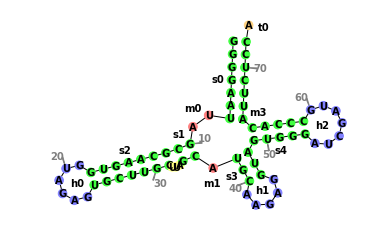

In [19]:
#Testing a random fold using the plot_rna function
cg = forgi.load_rna("examples/input/tRNA/0.fx", allow_many=False)
a = fvm.plot_rna(cg, text_kwargs={"fontweight":"black"}, lighten=0.5,
             backbone_kwargs={"linewidth":1})

In [103]:
# Iterating the process for all the entire file
for i, row in df.iterrows():
    file = 'examples/input/' + str(i) +'.fx'
    f = open(file,'w')
    f.write(str(row['Sequence']))
    f.write('\n')
    f.write(str(row['Dot_Bracket']))

In [5]:
def plot_im(num):
    fig,ax = plt.subplots(figsize=(10,10))
    cg = forgi.load_rna("examples/input/tRNA/" +str(num)+".fx", allow_many=False)
    fig = fvm.plot_rna(cg, text_kwargs={"fontweight":"black"}, lighten=0.7,backbone_kwargs={"linewidth":3})
    plt.savefig('examples/input/tRNA/folds/'+str(num)+'.png')

## Repeating the same process for miRNA sequences

1. Filtering the sequence
2. Removing the commas and genrating the dot bracket notation
3. Converting it to a datframe
4. Performing the fold and storing the image

In [6]:
file_in ='hairpin.fa'
file_out = 'clean.fa'
seq_id = []
seq = []
desc = []
with open(file_out, 'w') as f_out:
    for seq_record in SeqIO.parse(open(file_in, mode='r'), 'fasta'):
        seq_record.description=' '.join(seq_record.description.split()[1:])   
        seq_id.append(seq_record.id)
        seq.append(seq_record.seq)
        desc.append(seq_record.description)
        
df = pd.DataFrame({'ID':seq_id,'Description':desc,'Sequence':seq})

df.head()

,ID,Description,Sequence
0,cel-let-7,MI0000001 Caenorhabditis elegans let-7 stem-loop,"(U, A, C, A, C, U, G, U, G, G, A, U, C, C, G, ..."
1,cel-lin-4,MI0000002 Caenorhabditis elegans lin-4 stem-loop,"(A, U, G, C, U, U, C, C, G, G, C, C, U, G, U, ..."
2,cel-mir-1,MI0000003 Caenorhabditis elegans miR-1 stem-loop,"(A, A, A, G, U, G, A, C, C, G, U, A, C, C, G, ..."
3,cel-mir-2,MI0000004 Caenorhabditis elegans miR-2 stem-loop,"(U, A, A, A, C, A, G, U, A, U, A, C, A, G, A, ..."
4,cel-mir-34,MI0000005 Caenorhabditis elegans miR-34 stem-loop,"(C, G, G, A, C, A, A, U, G, C, U, C, G, A, G, ..."


In [7]:
new = df["Description"].str.split(" ", n = 1, expand = True) 
df['Description'] = new[1]

In [8]:
new = df["Description"].str.split(" ", n = 1, expand = True) 
new2 = new[1].str.split(" ", n = 1, expand = True) 

In [9]:
df['Description'] = new[0] + ' ' + new2[0]

In [10]:
df = df[df['Description']=='Homo sapiens']

In [11]:
df['Sequence'] = df['Sequence'].apply(convert_to_sequence)
df['Dot_Bracket'] = df['Sequence'].apply(convert_to_dot_bracket)

In [12]:
df.head()

,ID,Description,Sequence,Dot_Bracket
57,hsa-let-7a-1,Homo sapiens,UGGGAUGAGGUAGUAGGUUGUAUAGUUUUAGGGUCACACCCACCAC...,(((((.(((((((((((((((((((((.....(((...((((.......
58,hsa-let-7a-2,Homo sapiens,AGGUUGAGGUAGUAGGUUGUAUAGUUUAGAAUUACAUCAAGGGAGA...,(((..(((.(((.(((((((((((((.........(((......))...
59,hsa-let-7a-3,Homo sapiens,GGGUGAGGUAGUAGGUUGUAUAGUUUGGGGCUCUGCCCUGCUAUGG...,(((.(((((((((((((((((((((((((((...)))))).........
60,hsa-let-7b,Homo sapiens,CGGGGUGAGGUAGUAGGUUGUGUGGUUUCAGGGCAGUGAUGUUGCC...,(((((.(((((((((((((((((((((((.((((((.....)))))...
61,hsa-let-7c,Homo sapiens,GCAUCCGGGUUGAGGUAGUAGGUUGUAUGGUUUAGAGUUACACCCU...,((.((((((..(((.(((.(((((((((((((..((.(..((...)...


In [76]:
for i, row in df.iterrows():
    file = 'examples/input/miRNA' + str(i) +'.fx'
    f = open(file,'w')
    f.write(str(row['Sequence']))
    f.write('\n')
    f.write(str(row['Dot_Bracket']))

In [33]:
a = 1000
a = list(str(a))
a1 = a[0]
b1 = ''.join(a[1:])

In [36]:
def plot_im(a1,b1,num):
    fig,ax = plt.subplots(figsize=(10,10))
    cg = forgi.load_rna("examples/input/miRNA/miRNA" +a1+','+b1+".fx", allow_many=False)
    fig = fvm.plot_rna(cg, text_kwargs={"fontweight":"black"}, lighten=0.7,backbone_kwargs={"linewidth":3})
    plt.savefig('examples/input/miRNA/folds/'+str(num)+'.png')

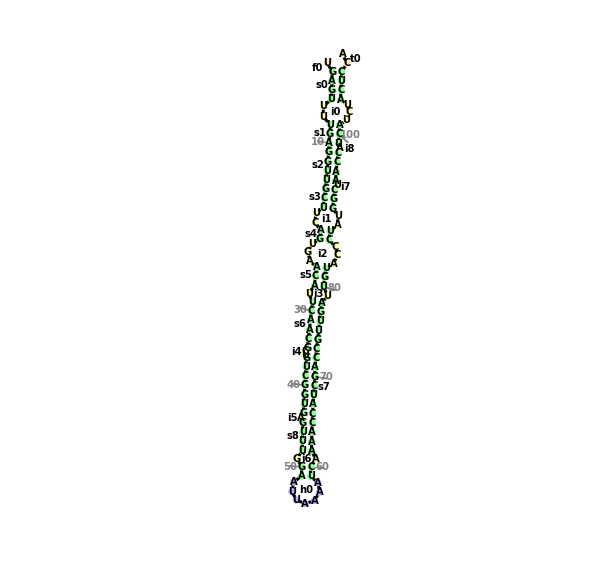

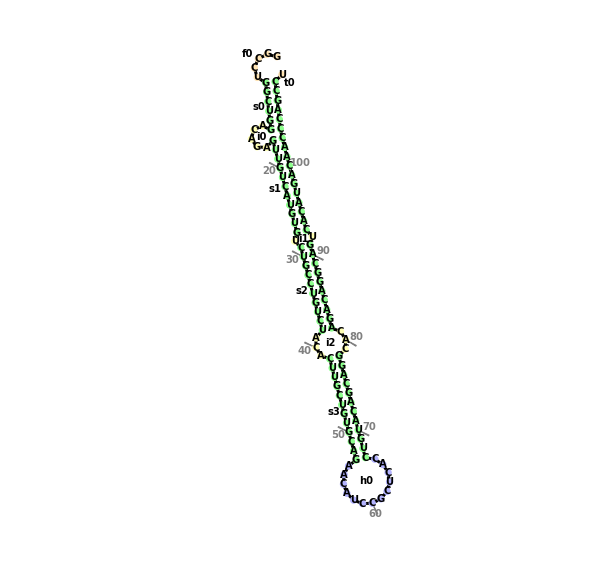

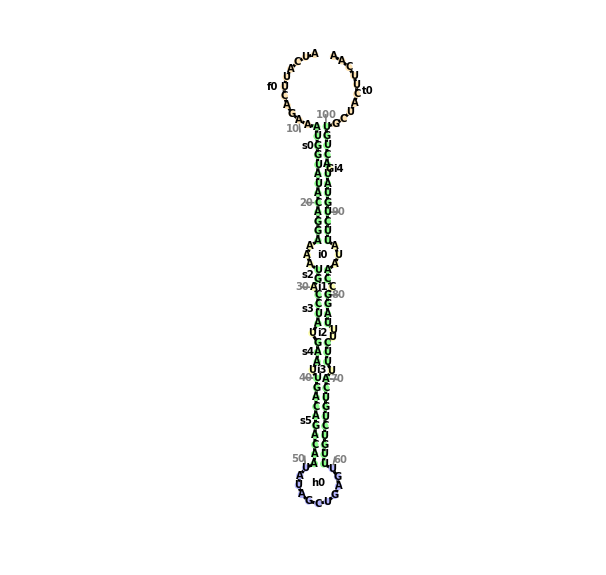

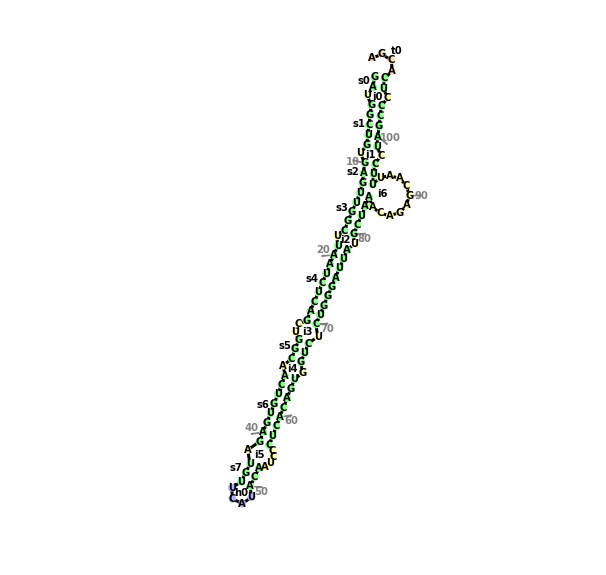

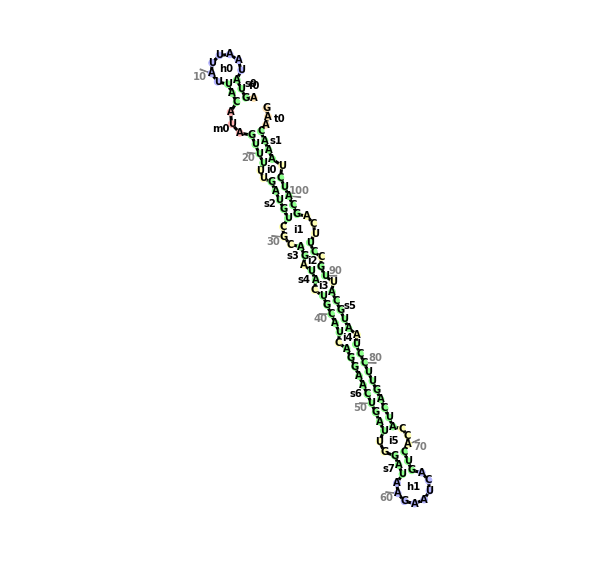

...

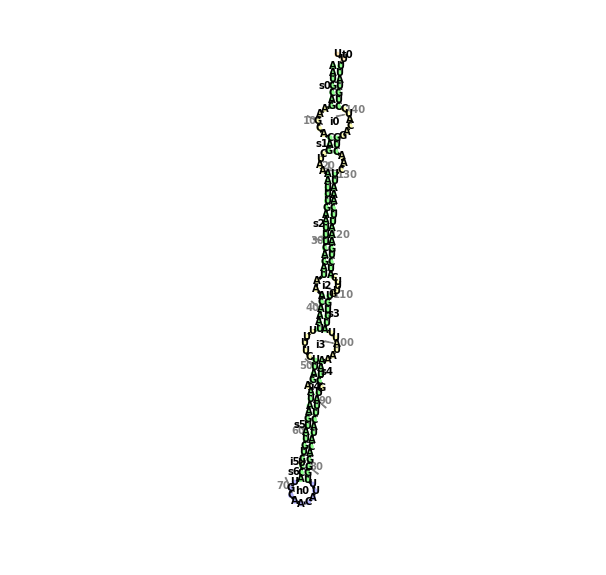

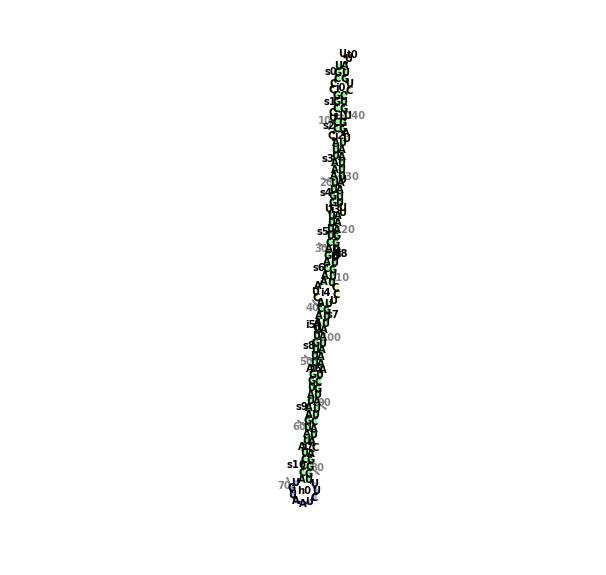

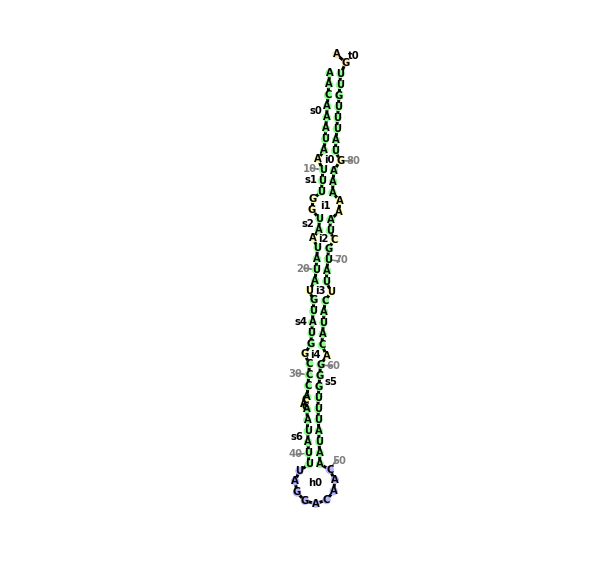

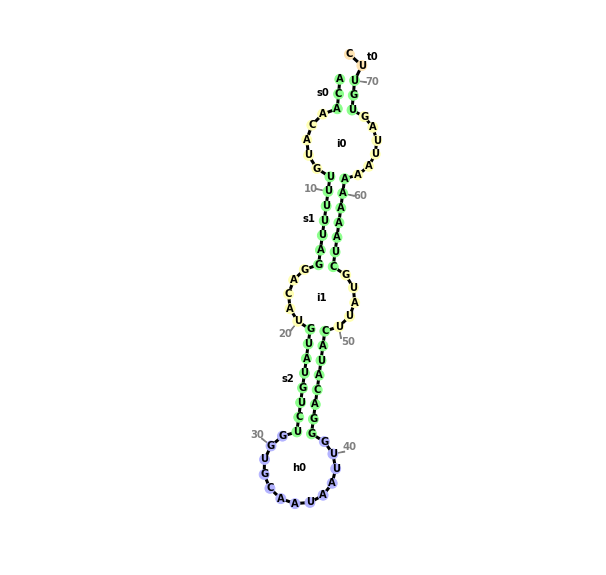

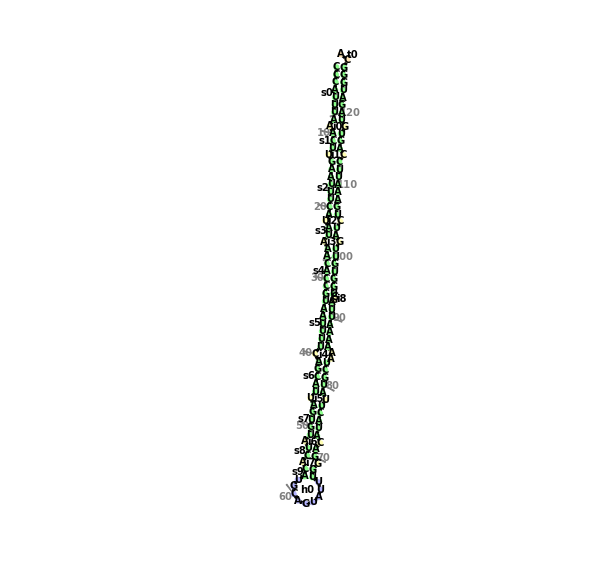

In [ ]:
for i in range(1000,1917):
    a = i
    a = list(str(a))
    a1 = a[0]
    b1 = ''.join(a[1:])
    plot_im(a1,b1,i)

## This is the end of part 1, please look into the part 2 for the model

#### References: 
1. https://www.nature.com/articles/s41598-018-22488-2
2. https://www.youtube.com/watch?v=Y4p6jhFaru4
3. https://www.youtube.com/watch?v=iI__5SP-zkE
4. https://www.youtube.com/watch?v=t5jroSCBBwk
5. https://en.wikipedia.org/wiki/MicroRNA
